In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import os
import pickle
import random
import time

import numpy as np
import pandas as pd
import tensorflow as tf

assert tf.__version__.startswith('2')

import PIL
from PIL import Image
import matplotlib.pyplot as plt

In [ ]:
from tensorflow import keras

In [ ]:
import keras.backend as K
from keras import Input, Model
from keras.layers import LeakyReLU, BatchNormalization, ReLU, Activation
from keras.layers import UpSampling2D, Conv2D, Concatenate, Dense, concatenate
from keras.layers import Flatten, Lambda, Reshape, ZeroPadding2D, add
from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator

In [ ]:
def conditioning_augmentation(x):

	mean = x[:, :128]
	log_sigma = x[:, 128:]

	stddev = tf.math.exp(log_sigma)
	epsilon = K.random_normal(shape=K.constant((mean.shape[1], ), dtype='int32'))
	c = mean + stddev * epsilon
	return c

def build_ca_network():

	input_layer1 = Input(shape=(1024,)) #size of the vocabulary in the text data
	mls = Dense(256)(input_layer1)
	mls = LeakyReLU(alpha=0.2)(mls)
	ca = Lambda(conditioning_augmentation)(mls)
	return Model(inputs=[input_layer1], outputs=[ca]) 

In [ ]:
def UpSamplingBlock(x, num_kernels):

	x = UpSampling2D(size=(2,2))(x)
	x = Conv2D(num_kernels, kernel_size=(3,3), padding='same', strides=1, use_bias=False,
				kernel_initializer='he_uniform')(x)
	x = BatchNormalization(gamma_initializer='ones', beta_initializer='zeros')(x) #prevent from mode collapse
	x = ReLU()(x)
	return x


def build_stage1_generator():

	input_layer1 = Input(shape=(1024,))
	ca = Dense(256)(input_layer1)
	ca = LeakyReLU(alpha=0.2)(ca)

	# Obtain the conditioned text
	c = Lambda(conditioning_augmentation)(ca)

	input_layer2 = Input(shape=(100,))
	concat = Concatenate(axis=1)([c, input_layer2]) 

	x = Dense(16384, use_bias=False)(concat) 
	x = ReLU()(x)
	x = Reshape((4, 4, 1024), input_shape=(16384,))(x)

	x = UpSamplingBlock(x, 512) 
	x = UpSamplingBlock(x, 256)
	x = UpSamplingBlock(x, 128)
	x = UpSamplingBlock(x, 64)   # upsampled our image to 64*64*3 

	x = Conv2D(3, kernel_size=3, padding='same', strides=1, use_bias=False,
				kernel_initializer='he_uniform')(x)
	x = Activation('tanh')(x)

	stage1_gen = Model(inputs=[input_layer1, input_layer2], outputs=[x, ca]) 
	return stage1_gen

In [ ]:
generator = build_stage1_generator()
generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 1024)]       0           []                               
                                                                                                  
 dense (Dense)                  (None, 256)          262400      ['input_1[0][0]']                
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 256)          0           ['dense[0][0]']                  
                                                                                                  
 lambda (Lambda)                (None, 128)          0           ['leaky_re_lu[0][0]']            
                                                                                              

In [ ]:
def ConvBlock(x, num_kernels, kernel_size=(4,4), strides=2, activation=True):

	x = Conv2D(num_kernels, kernel_size=kernel_size, padding='same', strides=strides, use_bias=False,
				kernel_initializer='he_uniform')(x)
	x = BatchNormalization(gamma_initializer='ones', beta_initializer='zeros')(x)
	
	if activation:
		x = LeakyReLU(alpha=0.2)(x)
	return x


def build_embedding_compressor():

    input_layer1 = Input(shape=(1024,)) 
    x = Dense(128)(input_layer1)
    x = ReLU()(x)

    model = Model(inputs=[input_layer1], outputs=[x])
    return model

# the discriminator is fed with two inputs, the feature from Generator and the text embedding
def build_stage1_discriminator():

	input_layer1 = Input(shape=(64, 64, 3))  

	x = Conv2D(64, kernel_size=(4,4), strides=2, padding='same', use_bias=False,
				kernel_initializer='he_uniform')(input_layer1)
	x = LeakyReLU(alpha=0.2)(x)

	x = ConvBlock(x, 128)
	x = ConvBlock(x, 256)
	x = ConvBlock(x, 512)

	# Obtain the compressed and spatially replicated text embedding
	input_layer2 = Input(shape=(4, 4, 128)) #2nd input to discriminator, text embedding
	concat = concatenate([x, input_layer2])

	x1 = Conv2D(512, kernel_size=(1,1), padding='same', strides=1, use_bias=False,
				kernel_initializer='he_uniform')(concat)
	x1 = BatchNormalization(gamma_initializer='ones', beta_initializer='zeros')(x)
	x1 = LeakyReLU(alpha=0.2)(x)

	# Flatten and add a FC layer to predict.
	x1 = Flatten()(x1)
	x1 = Dense(1)(x1)
	x1 = Activation('sigmoid')(x1)

	stage1_dis = Model(inputs=[input_layer1, input_layer2], outputs=[x1])  
	return stage1_dis

In [ ]:
discriminator = build_stage1_discriminator()
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 conv2d_5 (Conv2D)              (None, 32, 32, 64)   3072        ['input_3[0][0]']                
                                                                                                  
 leaky_re_lu_1 (LeakyReLU)      (None, 32, 32, 64)   0           ['conv2d_5[0][0]']               
                                                                                                  
 conv2d_6 (Conv2D)              (None, 16, 16, 128)  131072      ['leaky_re_lu_1[0][0]']          
                                                                                            

In [ ]:
def build_adversarial(generator_model, discriminator_model):

	input_layer1 = Input(shape=(1024,))  
	input_layer2 = Input(shape=(100,)) 
	input_layer3 = Input(shape=(4, 4, 128)) 

	x, ca = generator_model([input_layer1, input_layer2]) #text,noise

	discriminator_model.trainable = False 

	probabilities = discriminator_model([x, input_layer3]) 
	adversarial_model = Model(inputs=[input_layer1, input_layer2, input_layer3], outputs=[probabilities, ca])
	return adversarial_model

In [ ]:
ganstage1 = build_adversarial(generator, discriminator)
ganstage1.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 1024)]       0           []                               
                                                                                                  
 input_6 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 model (Functional)             [(None, 64, 64, 3),  10270400    ['input_5[0][0]',                
                                 (None, 256)]                     'input_6[0][0]']                
                                                                                                  
 input_7 (InputLayer)           [(None, 4, 4, 128)]  0           []                         

In [ ]:
def checkpoint_prefix():
	checkpoint_dir = './training_checkpoints'
	checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')

	return checkpoint_prefix

def adversarial_loss(y_true, y_pred):
	mean = y_pred[:, :128]
	ls = y_pred[:, 128:]
	loss = -ls + 0.5 * (-1 + tf.math.exp(2.0 * ls) + tf.math.square(mean))
	loss = K.mean(loss)
	return loss

def normalize(input_image, real_image):
	input_image = (input_image / 127.5) - 1
	real_image = (real_image / 127.5) - 1

	return input_image, real_image

def load_class_ids_filenames(class_id_path, filename_path):
	with open(class_id_path, 'rb') as file:
		class_id = pickle.load(file, encoding='latin1')

	with open(filename_path, 'rb') as file:
		filename = pickle.load(file, encoding='latin1')

	return class_id, filename

def load_text_embeddings(text_embeddings):
	with open(text_embeddings, 'rb') as file:
		embeds = pickle.load(file, encoding='latin1')
		embeds = np.array(embeds)

	return embeds

def load_bbox(data_path):
	bbox_path = data_path + '/bounding_boxes.txt'
	image_path = data_path + '/images.txt'
	bbox_df = pd.read_csv(bbox_path, delim_whitespace=True, header=None).astype(int)
	filename_df = pd.read_csv(image_path, delim_whitespace=True, header=None)

	filenames = filename_df[1].tolist()
	bbox_dict = {i[:-4]:[] for i in filenames[:2]}

	for i in range(0, len(filenames)):
		bbox = bbox_df.iloc[i][1:].tolist()
		dict_key = filenames[i][:-4]
		bbox_dict[dict_key] = bbox

	return bbox_dict

def load_images(image_path, bounding_box, size):
	
	image = Image.open(image_path).convert('RGB')
	w, h = image.size
	if bounding_box is not None:
		r = int(np.maximum(bounding_box[2], bounding_box[3]) * 0.75)
		c_x = int((bounding_box[0] + bounding_box[2]) / 2)
		c_y = int((bounding_box[1] + bounding_box[3]) / 2)
		y1 = np.maximum(0, c_y - r)
		y2 = np.minimum(h, c_y + r)
		x1 = np.maximum(0, c_x - r)
		x2 = np.minimum(w, c_x + r)
		image = image.crop([x1, y1, x2, y2])

	image = image.resize(size, PIL.Image.BILINEAR)
	return image

def load_data(filename_path, class_id_path, dataset_path, embeddings_path, size):

	data_dir = "/content/drive/MyDrive/Text_to_image/birds"
	train_dir = data_dir + "/train"
	test_dir = data_dir + "/test"
	embeddings_path_train = train_dir + "/char-CNN-RNN-embeddings.pickle"
	embeddings_path_test = test_dir + "/char-CNN-RNN-embeddings.pickle"
	filename_path_train = train_dir + "/filenames.pickle"
	filename_path_test = test_dir + "/filenames.pickle"
	class_id_path_train = train_dir + "/class_info.pickle"
	class_id_path_test = test_dir + "/class_info.pickle"
	dataset_path = "/content/drive/MyDrive/Text_to_image/CUB_200_2011"
	class_id, filenames = load_class_ids_filenames(class_id_path, filename_path)
	embeddings = load_text_embeddings(embeddings_path)
	bbox_dict = load_bbox(dataset_path)

	x, y, embeds = [], [], []

	for i, filename in enumerate(filenames):
		bbox = bbox_dict[filename]

		try:	
			image_path = f'{dataset_path}/images/{filename}.jpg'
			image = load_images(image_path, bbox, size)
			e = embeddings[i, :, :]
			embed_index = np.random.randint(0, e.shape[0] - 1)
			embed = e[embed_index, :]

			x.append(np.array(image))
			y.append(class_id[i])
			embeds.append(embed)

		except Exception as e:
			print(f'{e}')
	
	x = np.array(x)
	y = np.array(y)
	embeds = np.array(embeds)
	
	return x, y, embeds

def save_image(file, save_path):

	image = plt.figure()
	ax = image.add_subplot(1,1,1)
	ax.imshow(file)
	ax.axis("off")
	plt.savefig(save_path)

In [ ]:
class StackGanStage1(object):
  """StackGAN Stage 1 class."""

  data_dir = "/content/drive/MyDrive/Text_to_image/birds"
  train_dir = data_dir + "/train"
  test_dir = data_dir + "/test"
  embeddings_path_train = train_dir + "/char-CNN-RNN-embeddings.pickle"
  embeddings_path_test = test_dir + "/char-CNN-RNN-embeddings.pickle"
  filename_path_train = train_dir + "/filenames.pickle"
  filename_path_test = test_dir + "/filenames.pickle"
  class_id_path_train = train_dir + "/class_info.pickle"
  class_id_path_test = test_dir + "/class_info.pickle"
  dataset_path = "/content/drive/MyDrive/Text_to_image/CUB_200_2011"
  def __init__(self, epochs=500, z_dim=100, batch_size=64, enable_function=True, stage1_generator_lr=0.0002, stage1_discriminator_lr=0.0002):
	  self.epochs = epochs
	  self.z_dim = z_dim
	  self.enable_function = enable_function
	  self.stage1_generator_lr = stage1_generator_lr
	  self.stage1_discriminator_lr = stage1_discriminator_lr
	  self.image_size = 64
	  self.conditioning_dim = 128
	  self.batch_size = batch_size
        
	  self.stage1_generator_optimizer = Adam(lr=stage1_generator_lr, beta_1=0.5, beta_2=0.999)
	  self.stage1_discriminator_optimizer = Adam(lr=stage1_discriminator_lr, beta_1=0.5, beta_2=0.999)
        
	  self.stage1_generator = build_stage1_generator()
	  self.stage1_generator.compile(loss='mse', optimizer=self.stage1_generator_optimizer)

	  self.stage1_discriminator = build_stage1_discriminator()
	  self.stage1_discriminator.compile(loss='binary_crossentropy', optimizer=self.stage1_discriminator_optimizer)

	  self.ca_network = build_ca_network()
	  self.ca_network.compile(loss='binary_crossentropy', optimizer='Adam')

	  self.embedding_compressor = build_embedding_compressor()
	  self.embedding_compressor.compile(loss='binary_crossentropy', optimizer='Adam')

	  self.stage1_adversarial = build_adversarial(self.stage1_generator, self.stage1_discriminator)
	  self.stage1_adversarial.compile(loss=['binary_crossentropy', adversarial_loss], loss_weights=[1, 2.0], optimizer=self.stage1_generator_optimizer)

	  self.checkpoint1 = tf.train.Checkpoint(
        	generator_optimizer=self.stage1_generator_optimizer,
        	discriminator_optimizer=self.stage1_discriminator_optimizer,
        	generator=self.stage1_generator,
        	discriminator=self.stage1_discriminator)

  def visualize_stage1(self):
	  """Running Tensorboard visualizations.
		"""
	  tb = TensorBoard(log_dir="logs/".format(time.time()))
	  tb.set_model(self.stage1_generator)
	  tb.set_model(self.stage1_discriminator)
	  tb.set_model(self.ca_network)
	  tb.set_model(self.embedding_compressor)

  def train_stage1(self):
	  """Trains the stage1 StackGAN.
    """
	  x_train, y_train, train_embeds = load_data(filename_path=self.filename_path_train, class_id_path=self.class_id_path_train,
      dataset_path=self.dataset_path, embeddings_path=self.embeddings_path_train, size=(64, 64))

	  x_test, y_test, test_embeds = load_data(filename_path=self.filename_path_test, class_id_path=self.class_id_path_test, 
      dataset_path=self.dataset_path, embeddings_path=self.embeddings_path_test, size=(64, 64))

	  real = np.ones((self.batch_size, 1), dtype='float') * 0.9
	  fake = np.zeros((self.batch_size, 1), dtype='float') * 0.1

	  for epoch in range(self.epochs):
		  print(f'Epoch: {epoch}')

		  gen_loss = []
		  dis_loss = []

		  num_batches = int(x_train.shape[0] / self.batch_size)

		  for i in range(num_batches):

		    latent_space = np.random.normal(0, 1, size=(self.batch_size, self.z_dim))
		    embedding_text = train_embeds[i * self.batch_size:(i + 1) * self.batch_size]
		    compressed_embedding = self.embedding_compressor.predict_on_batch(embedding_text)
		    compressed_embedding = np.reshape(compressed_embedding, (-1, 1, 1, 128))
		    compressed_embedding = np.tile(compressed_embedding, (1, 4, 4, 1))

		    image_batch = x_train[i * self.batch_size:(i+1) * self.batch_size]
		    image_batch = (image_batch - 127.5) / 127.5

		    gen_images, _ = self.stage1_generator.predict([embedding_text, latent_space])

		    discriminator_loss = self.stage1_discriminator.train_on_batch([image_batch, compressed_embedding], 
					np.reshape(real, (self.batch_size, 1)))

		    discriminator_loss_gen = self.stage1_discriminator.train_on_batch([gen_images, compressed_embedding],
					np.reshape(fake, (self.batch_size, 1)))

		    discriminator_loss_wrong = self.stage1_discriminator.train_on_batch([gen_images[: self.batch_size-1], compressed_embedding[1:]], 
					np.reshape(fake[1:], (self.batch_size-1, 1)))

		    # Discriminator loss
		    d_loss = 0.5 * np.add(discriminator_loss, 0.5 * np.add(discriminator_loss_gen, discriminator_loss_wrong))
		    dis_loss.append(d_loss)

		    print(f'Discriminator Loss: {d_loss}')

		    # Generator loss
		    g_loss = self.stage1_adversarial.train_on_batch([embedding_text, latent_space, compressed_embedding],
					[K.ones((self.batch_size, 1)) * 0.9, K.ones((self.batch_size, 256)) * 0.9])

		    print(f'Generator Loss: {g_loss}')
		    gen_loss.append(g_loss)

		    if epoch % 5 == 0:
				    latent_space = np.random.normal(0, 1, size=(self.batch_size, self.z_dim))
				    embedding_batch = test_embeds[0 : self.batch_size]
				    gen_images, _ = self.stage1_generator.predict_on_batch([embedding_batch, latent_space])

				    for i, image in enumerate(gen_images[:10]):
				        save_image(image,"/content/drive/MyDrive/Text_to_image/test")

		    if epoch % 25 == 0:
		      self.stage1_generator.save_weights("/content/drive/MyDrive/Text_to_image/weights/stage1_gen.h5")
		      self.stage1_discriminator.save_weights("/content/drive/MyDrive/Text_to_image/weights/stage1_disc.h5")
		      self.ca_network.save_weights("/content/drive/MyDrive/Text_to_image/weights/stage1_ca.h5")
		      self.embedding_compressor.save_weights("/content/drive/MyDrive/Text_to_image/weights/stage1_embco.h5")
		      self.stage1_adversarial.save_weights("/content/drive/MyDrive/Text_to_image/weights/stage1_adv.h5")      

	  self.stage1_generator.save_weights("/content/drive/MyDrive/Text_to_image/weights/stage1_gen.h5")
	  self.stage1_discriminator.save_weights("/content/drive/MyDrive/Text_to_image/weights/stage1_disc.h5")


		    

/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Epoch: 0
2/2 [==============================] - 5s 2s/step
Discriminator Loss: 0.9320411114022136
Generator Loss: [0.867389976978302, 0.8275806903839111, 0.01990465074777603]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.6674262005835772
Generator Loss: [1.4130761623382568, 1.3684287071228027, 0.02232373133301735]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.4192928969860077
Generator Loss: [1.2445467710494995, 1.206621527671814, 0.018962625414133072]


<ipython-input-12-6d4eeae09ac4>:112: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  image = plt.figure()


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.5428606254281476
Generator Loss: [1.025661587715149, 0.9809238910675049, 0.022368866950273514]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.44195038359612226
Generator Loss: [1.060420036315918, 1.0202150344848633, 0.020102523267269135]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.5047044780803844
Generator Loss: [0.7717304229736328, 0.7300573587417603, 0.020836522802710533]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.4176082145422697
Generator Loss: [1.1570991277694702, 1.1221606731414795, 0.017469201236963272]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.4085741622839123
Generator Loss: [0.4355952739715576, 0.3631608486175537, 0.03621721267700195]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.34228641545632854
Generator Loss: [0.4290785789489746, 0.34874874353408813, 0.040164925158023834]


2/2 [==============================] - 5s 2s/step
Discriminator Loss: 0.24517025539535098
Generator Loss: [1.2077168226242065, 1.1538846492767334, 0.026916058734059334]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.2666949965059757
Generator Loss: [0.6835342645645142, 0.640317976474762, 0.0216081365942955]


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.27638944011414424
Generator Loss: [0.5702544450759888, 0.5306515693664551, 0.0198014285415411]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.21472306083887815
Generator Loss: [0.8262494206428528, 0.7912739515304565, 0.01748773455619812]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.4003924832941266
Generator Loss: [3.989762306213379, 3.9594168663024902, 0.01517268642783165]


2/2 [==============================] - 6s 2s/step
Discriminator Loss: 0.3572525780182332
Generator Loss: [0.467283695936203, 0.4092470407485962, 0.029018327593803406]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.2407048469176516
Generator Loss: [1.0242875814437866, 0.9769918322563171, 0.02364789880812168]


2/2 [==============================] - 5s 2s/step
Discriminator Loss: 0.33521839496461325
Generator Loss: [0.40370845794677734, 0.35927867889404297, 0.02221488580107689]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.2323308913037181
Generator Loss: [0.7820794582366943, 0.7520487308502197, 0.015015363693237305]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.28866470682260115
Generator Loss: [3.4754207134246826, 3.443101644515991, 0.016159534454345703]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.4233236472355202
Generator Loss: [0.4433685839176178, 0.41288021206855774, 0.01524418592453003]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.2422110351617448
Generator Loss: [0.4704866409301758, 0.43899235129356384, 0.01574714109301567]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.27312227216316387
Generator Loss: [0.8461886644363403, 0.813522458076477, 0.016333090141415596]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.21654988736190717
Generator Loss: [0.43417808413505554, 0.39934220910072327, 0.017417937517166138]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19641493940434884
Generator Loss: [0.6012153029441833, 0.5578741431236267, 0.02167057991027832]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19808208663016558
Generator Loss: [0.6251245141029358, 0.5846405029296875, 0.020242009311914444]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1956449627323309
Generator Loss: [0.37452635169029236, 0.3428501486778259, 0.015838099643588066]


2/2 [==============================] - 5s 2s/step
Discriminator Loss: 0.1941989730403293
Generator Loss: [0.39674779772758484, 0.36348670721054077, 0.016630545258522034]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.2017731883970555
Generator Loss: [0.5518487095832825, 0.5024908185005188, 0.024678943678736687]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.21460659854346886
Generator Loss: [0.5877130031585693, 0.5407682657241821, 0.0234723798930645]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.20290301482600626
Generator Loss: [0.37980490922927856, 0.3457998037338257, 0.01700255274772644]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.18492784838599619
Generator Loss: [0.3737625181674957, 0.34237363934516907, 0.01569443568587303]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.18793998593173455
Generator Loss: [0.37956345081329346, 0.3385111093521118, 0.020526163280010223]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18734323181706714
Generator Loss: [0.40276336669921875, 0.3659942150115967, 0.018384572118520737]


2/2 [==============================] - 8s 4s/step
Discriminator Loss: 0.18257036665454507
Generator Loss: [0.4001317620277405, 0.3669073283672333, 0.016612211242318153]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.18704143413924612
Generator Loss: [0.38705506920814514, 0.34994325041770935, 0.018555903807282448]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18347578543034615
Generator Loss: [0.46310168504714966, 0.43037575483322144, 0.016362957656383514]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17202736301260302
Generator Loss: [0.37857818603515625, 0.34453409910202026, 0.01702204719185829]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1801281492516864
Generator Loss: [0.5875795483589172, 0.5563927292823792, 0.015593402087688446]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17385666361951735
Generator Loss: [0.6884034276008606, 0.6545231342315674, 0.01694013550877571]


2/2 [==============================] - 5s 3s/step
Discriminator Loss: 0.18649830063804984
Generator Loss: [0.56351238489151, 0.531010627746582, 0.016250865533947945]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1790335412370041
Generator Loss: [0.37996166944503784, 0.34941279888153076, 0.015274439938366413]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1765563973240205
Generator Loss: [0.48338109254837036, 0.45164674520492554, 0.015867173671722412]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17554999284038786
Generator Loss: [0.4174066483974457, 0.37518587708473206, 0.02111038751900196]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17552737590449397
Generator Loss: [0.46689966320991516, 0.4295974373817444, 0.018651112914085388]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.17804380753659643
Generator Loss: [0.3829784393310547, 0.34439337253570557, 0.019292540848255157]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17692071896453854
Generator Loss: [0.46138110756874084, 0.421205073595047, 0.020088013261556625]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.17851470239111222
Generator Loss: [0.3836250901222229, 0.34977397322654724, 0.01692556031048298]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.17427093484729994
Generator Loss: [0.37514713406562805, 0.33691468834877014, 0.019116217270493507]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18216582049353747
Generator Loss: [0.39673474431037903, 0.356628954410553, 0.020052898675203323]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17718844987393823
Generator Loss: [0.5082962512969971, 0.47572699189186096, 0.01628463715314865]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.17746323032770306
Generator Loss: [0.3697671592235565, 0.3414660692214966, 0.014150543138384819]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17500643827952445
Generator Loss: [0.478076696395874, 0.45341992378234863, 0.012328382581472397]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17577222021645866
Generator Loss: [0.5746017694473267, 0.5410504341125488, 0.01677568070590496]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1810508257622132
Generator Loss: [0.45228540897369385, 0.4198153614997864, 0.016235020011663437]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.17133028332682443
Generator Loss: [0.37811997532844543, 0.34808099269866943, 0.015019491314888]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.19229977641589358
Generator Loss: [0.36959829926490784, 0.3388638496398926, 0.015367221087217331]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19040557493281085
Generator Loss: [0.3881911039352417, 0.3557601869106293, 0.016215462237596512]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1788177958333108
Generator Loss: [0.7197999954223633, 0.6930099725723267, 0.013395015150308609]


2/2 [==============================] - 5s 2s/step
Discriminator Loss: 0.17362155759474263
Generator Loss: [0.39329105615615845, 0.36607423424720764, 0.013608410954475403]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18817832531931344
Generator Loss: [0.4110232889652252, 0.38412392139434814, 0.013449682854115963]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18116863882460166
Generator Loss: [0.3602113723754883, 0.33876273036003113, 0.010724326595664024]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.17535866756225005
Generator Loss: [0.3986528217792511, 0.3772505819797516, 0.010701116174459457]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1777196260954952
Generator Loss: [0.3739691376686096, 0.34777987003326416, 0.01309463381767273]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1765388645726489
Generator Loss: [0.42371657490730286, 0.39713630080223083, 0.01329013891518116]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18243111956689972
Generator Loss: [0.7903889417648315, 0.7583141326904297, 0.016037406399846077]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.16992070971173234
Generator Loss: [0.3677070438861847, 0.34356266260147095, 0.012072188779711723]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17364874445775058
Generator Loss: [0.5091072916984558, 0.48800140619277954, 0.01055295579135418]


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.17387096457969164
Generator Loss: [0.5414929389953613, 0.5169636607170105, 0.012264642864465714]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.170890356937889
Generator Loss: [0.37847673892974854, 0.35437995195388794, 0.01204838789999485]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17419101500127
Generator Loss: [0.5653855204582214, 0.5413764715194702, 0.012004513293504715]


2/2 [==============================] - 9s 5s/step
Discriminator Loss: 0.18141110514989123
Generator Loss: [0.5140572786331177, 0.4884202480316162, 0.012818525545299053]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17582338822830934
Generator Loss: [0.39670681953430176, 0.3766462802886963, 0.010030277073383331]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.1716514349282079
Generator Loss: [0.5392876863479614, 0.5183281898498535, 0.010479748249053955]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1788115127128549
Generator Loss: [0.5106527805328369, 0.4905312955379486, 0.010060747154057026]


2/2 [==============================] - 5s 3s/step
Discriminator Loss: 0.1812058332579909
Generator Loss: [0.41236618161201477, 0.3909561336040497, 0.010705024935305119]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17090953666775022
Generator Loss: [0.5985861420631409, 0.5777364373207092, 0.010424839332699776]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17680359656515066
Generator Loss: [0.39183497428894043, 0.3740554451942444, 0.008889760822057724]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1796107105910778
Generator Loss: [0.3918195366859436, 0.37083011865615845, 0.01049470528960228]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.18633436219533905
Generator Loss: [0.3830622136592865, 0.3631092607975006, 0.009976474568247795]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19996770724537782
Generator Loss: [0.601186990737915, 0.5802769660949707, 0.010455021634697914]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17948390109813772
Generator Loss: [0.44267141819000244, 0.4196871817111969, 0.011492111720144749]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.17594638298032805
Generator Loss: [0.39304277300834656, 0.3742640018463135, 0.009389386512339115]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1738781866733916
Generator Loss: [0.44438883662223816, 0.42439737915992737, 0.009995725005865097]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18278193374862894
Generator Loss: [0.42928141355514526, 0.40810471773147583, 0.010588341392576694]


2/2 [==============================] - 5s 2s/step
Discriminator Loss: 0.18999611312756315
Generator Loss: [0.5169436931610107, 0.49867236614227295, 0.009135670028626919]


2/2 [==============================] - 5s 2s/step
Discriminator Loss: 0.18706386519625084
Generator Loss: [1.4539790153503418, 1.4353371858596802, 0.009320941753685474]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.5472123473891748
Generator Loss: [25.314733505249023, 25.291227340698242, 0.011753271333873272]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 2.5807236817090455
Generator Loss: [30.611572265625, 30.586410522460938, 0.012580526992678642]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.6346199585055388
Generator Loss: [12.902013778686523, 12.866734504699707, 0.017639553174376488]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.569167166958134
Generator Loss: [21.637243270874023, 21.608348846435547, 0.01444694772362709]


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 1.1754398522390366
Generator Loss: [2.2845897674560547, 2.2586097717285156, 0.012989944778382778]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.284201813468826
Generator Loss: [3.289595365524292, 3.259056568145752, 0.015269400551915169]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.3148258734731826
Generator Loss: [1.257585883140564, 1.22513747215271, 0.01622418314218521]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.2854335575480036
Generator Loss: [1.3585431575775146, 1.3261077404022217, 0.016217738389968872]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.29422262123944165
Generator Loss: [0.6268873810768127, 0.5990975499153137, 0.013894902542233467]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.22090257829404436
Generator Loss: [6.1527791023254395, 6.116985321044922, 0.017896868288517]


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.25943483485025354
Generator Loss: [1.0735061168670654, 1.0399837493896484, 0.016761209815740585]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.22365118315792643
Generator Loss: [0.6490375995635986, 0.613284707069397, 0.017876435071229935]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.24045479240248824
Generator Loss: [0.5186121463775635, 0.48273539543151855, 0.01793837733566761]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.21797853225143626
Generator Loss: [0.6699331402778625, 0.6348384022712708, 0.017547378316521645]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.20572705916129053
Generator Loss: [0.6232421398162842, 0.5931282043457031, 0.015056971460580826]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19774787770235758
Generator Loss: [0.43468570709228516, 0.4072847366333008, 0.013700487092137337]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.22428076512832718
Generator Loss: [0.38779762387275696, 0.3562740981578827, 0.015761764720082283]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.23760290030804754
Generator Loss: [0.47740450501441956, 0.448637455701828, 0.014383520931005478]


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.2078257643734105
Generator Loss: [0.4321599304676056, 0.4071267247200012, 0.012516604736447334]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19146920956484337
Generator Loss: [0.5858085751533508, 0.560396134853363, 0.012706207111477852]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19155556414443708
Generator Loss: [0.4563578963279724, 0.4240521490573883, 0.016152869910001755]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19274804683573166
Generator Loss: [0.5678679943084717, 0.5413042306900024, 0.013281889259815216]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.1992966312354838
Generator Loss: [0.4672808349132538, 0.4380680322647095, 0.014606406912207603]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.1867848555848468
Generator Loss: [0.4311062693595886, 0.40056926012039185, 0.015268510207533836]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.19150849982906948
Generator Loss: [0.4347703456878662, 0.4001689553260803, 0.017300687730312347]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18876963044272088
Generator Loss: [0.4881518483161926, 0.45363759994506836, 0.01725713163614273]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.1888652857123816
Generator Loss: [0.39049357175827026, 0.3554950952529907, 0.017499232664704323]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.19009201382868923
Generator Loss: [0.3832527995109558, 0.34329473972320557, 0.019979028031229973]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.1794141423979454
Generator Loss: [0.36896777153015137, 0.33783388137817383, 0.015566948801279068]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18805100687313825
Generator Loss: [0.39013662934303284, 0.3615434169769287, 0.014296609908342361]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.18446145843336126
Generator Loss: [1.0784387588500977, 1.0468276739120483, 0.015805529430508614]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.1804792063194327
Generator Loss: [0.3669239282608032, 0.3362770974636078, 0.01532340981066227]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1860943649953697
Generator Loss: [1.7223036289215088, 1.6955373287200928, 0.013383138924837112]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18080148627632298
Generator Loss: [0.7600118517875671, 0.7202962636947632, 0.019857797771692276]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.18093280016910285
Generator Loss: [0.40649697184562683, 0.3740190863609314, 0.016238946467638016]


2/2 [==============================] - 4s 1s/step
Discriminator Loss: 0.17613620546762832
Generator Loss: [0.4257652759552002, 0.3920178711414337, 0.01687369868159294]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.22178083925973624
Generator Loss: [0.8505832552909851, 0.8226476907730103, 0.013967770151793957]


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.18374525045510381
Generator Loss: [0.501526951789856, 0.4704752564430237, 0.01552585605531931]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18629706364299636
Generator Loss: [0.3971075415611267, 0.3571530282497406, 0.019977251067757607]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1738333471585065
Generator Loss: [0.5003045797348022, 0.4656701683998108, 0.017317194491624832]


2/2 [==============================] - 3s 2s/step
Discriminator Loss: 0.17474094693898223
Generator Loss: [0.754768967628479, 0.7288789749145508, 0.012944983318448067]


2/2 [==============================] - 5s 3s/step
Discriminator Loss: 0.179053793210187
Generator Loss: [0.4377026855945587, 0.4003463685512543, 0.01867816038429737]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17094706614261668
Generator Loss: [0.39108070731163025, 0.35559046268463135, 0.01774512231349945]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17256910330615938
Generator Loss: [0.441893994808197, 0.41713932156562805, 0.012377344071865082]


2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.17290012713056058
Generator Loss: [0.39705297350883484, 0.36596331000328064, 0.015544828958809376]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17194067917444045
Generator Loss: [0.3743550777435303, 0.3451996445655823, 0.014577711001038551]


2/2 [==============================] - 4s 2s/step
Discriminator Loss: 0.1711285152414348
Generator Loss: [0.3665396273136139, 0.3433365821838379, 0.011601518839597702]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17355466420849552
Generator Loss: [0.3847963809967041, 0.3552182614803314, 0.014789066277444363]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1826581632194575
Generator Loss: [0.7343223094940186, 0.7075337171554565, 0.013394300825893879]


2/2 [==============================] - 5s 3s/step
Discriminator Loss: 0.17948953562881798
Generator Loss: [0.5517536997795105, 0.5306603908538818, 0.010546667501330376]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17669996283802902
Generator Loss: [0.5022369027137756, 0.47790712118148804, 0.012164885178208351]


2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17564733720791992
Generator Loss: [0.44530996680259705, 0.41553038358688354, 0.014889798127114773]


Epoch: 1
2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18847478416137164
Generator Loss: [0.36049360036849976, 0.33785295486450195, 0.011320320889353752]
2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.1730107554612914
Generator Loss: [0.4459569454193115, 0.41903144121170044, 0.013462759554386139]
2/2 [==============================] - 4s 3s/step
Discriminator Loss: 0.17311394779244438
Generator Loss: [0.42601969838142395, 0.3968883156776428, 0.014565696939826012]
2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.18370001527728164
Generator Loss: [0.37082749605178833, 0.3378317654132843, 0.016497859731316566]
2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17540528350218665
Generator Loss: [0.3684489130973816, 0.3369986116886139, 0.0157251488417387]
2/2 [==============================] - 3s 1s/step
Discriminator Loss: 0.17797099032759434
Generator Loss: [0.4339180588722229, 0.402614474296569

KeyboardInterrupt: ignored

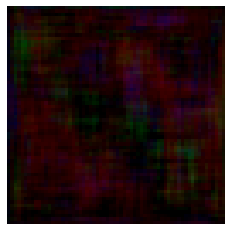

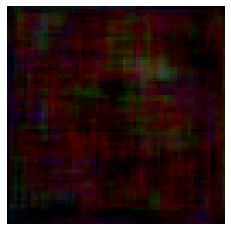

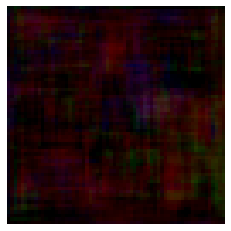

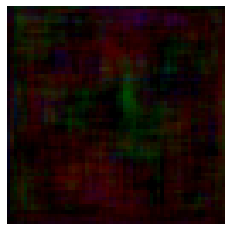

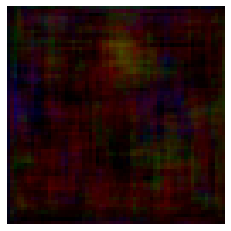

...

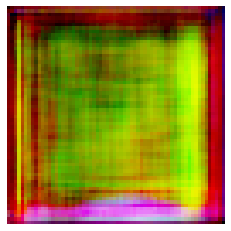

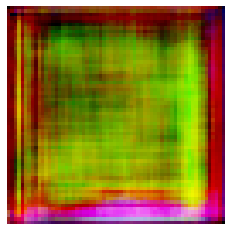

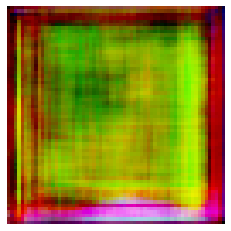

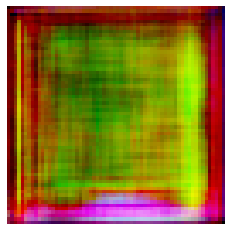

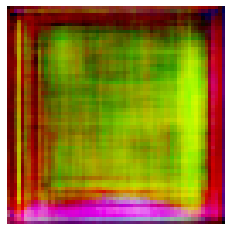

In [16]:
stage1 = StackGanStage1()
stage1.train_stage1()